<a href="https://colab.research.google.com/github/Jeremy26/tracking_course/blob/master/Hungarian.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Welcome to the Tracking Project!

In this project, you will learn to associate bounding boxes on multiple frames using the Hungarian Algorithm!

You will work on 3 aspects of the **multi-object tracker**:

*   Use YOLO and launch an object detection algorithm
*   Use The Hungarian Algorithm and associate the boxes
*   Improve the algorithm to avoid false positives and false negatives

In [ ]:
!wget https://thinkautonomous-tracking.s3.eu-west-3.amazonaws.com/tracking.zip && unzip tracking.zip

--2022-02-28 13:02:34--  https://thinkautonomous-tracking.s3.eu-west-3.amazonaws.com/tracking.zip
Resolving thinkautonomous-tracking.s3.eu-west-3.amazonaws.com (thinkautonomous-tracking.s3.eu-west-3.amazonaws.com)... 52.95.156.64
Connecting to thinkautonomous-tracking.s3.eu-west-3.amazonaws.com (thinkautonomous-tracking.s3.eu-west-3.amazonaws.com)|52.95.156.64|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 824310377 (786M) [application/zip]
Saving to: ‘tracking.zip’

tracking.zip        100%[===================>] 786.12M  32.9MB/s    in 31s     

2022-02-28 13:03:06 (25.1 MB/s) - ‘tracking.zip’ saved [824310377/824310377]

Archive:  tracking.zip
   creating: data/
  inflating: __MACOSX/._data         
  inflating: data/0000000791.png     
  inflating: __MACOSX/data/._0000000791.png  
  inflating: data/0000000785.png     
  inflating: __MACOSX/data/._0000000785.png  
  inflating: data/0000000752.png     
  inflating: __MACOSX/data/._0000000752.png  
  inflatin

## Imports

In [ ]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import copy
import glob
import pickle
import cv2
import numpy as np

## Load & Visualize the Images

In [ ]:
def visualize_images(input_images):
    fig=plt.figure(figsize=(150,75))
    for i in range(len(input_images)):
        fig.add_subplot(1, len(input_images), i+1)
        plt.imshow(input_images[i])
    plt.show()

In [ ]:
images= sorted(glob.glob("data/*.png"))
track_images = []

for img in images[100:110]:
    track_images.append(cv2.cvtColor(cv2.imread(img), cv2.COLOR_BGR2RGB))

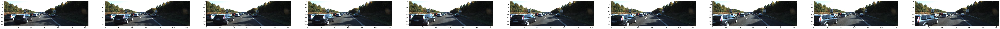

In [ ]:
visualize_images(track_images)

## 1) YOLO — Object Detection

-- Just copy and paste the parts from the object detection workshop

In [ ]:
!python3 -m pip install yolov4==2.0.2 # After Checking, YOLO 2.0.2 works without modifying anything. Otherwise keep 1.2.1

  Created wheel for yolov4: filename=yolov4-2.0.2-py3-none-any.whl size=39757 sha256=b3c33664d399c7fd8ee2984cf9446864411bb01d6cc128fa2f2e0ee955dc1440
  Stored in directory: /root/.cache/pip/wheels/a6/ef/cb/2a9464b7d9903f97dc6ff06efc72e5b793e07116adca7e8907
Successfully built yolov4


In [ ]:
from yolov4.tf import YOLOv4
import tensorflow as tf
import time

yolo = YOLOv4(tiny=False)
yolo.classes = "Yolov4/coco.names"
yolo.make_model()
yolo.load_weights("Yolov4/yolov4.weights", weights_type="yolo")

def run_obstacle_detection(img):
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    resized_image = yolo.resize_image(img)
    resized_image = resized_image / 255. # 0 ~ 255 to 0.0 ~ 1.0
    input_data = resized_image[np.newaxis, ...].astype(np.float32)
    candidates = yolo.model.predict(input_data)
    _candidates = []
    result = img.copy()
    for candidate in candidates:
        batch_size = candidate.shape[0]
        grid_size = candidate.shape[1]
        _candidates.append(tf.reshape(candidate, shape=(1, grid_size * grid_size * 3, -1)))
        candidates = np.concatenate(_candidates, axis=1)
        pred_bboxes = yolo.candidates_to_pred_bboxes(candidates[0], iou_threshold=0.35, score_threshold=0.50)
        pred_bboxes = pred_bboxes[~(pred_bboxes==0).all(1)] #https://stackoverflow.com/questions/35673095/python-how-to-eliminate-all-the-zero-rows-from-a-matrix-in-numpy?lq=1
        pred_bboxes = yolo.fit_pred_bboxes_to_original(pred_bboxes, img.shape)
        result = yolo.draw_bboxes(img, pred_bboxes)
    return result, pred_bboxes

def id_to_color(idx):
    """
    Random function to convert an id to a color
    Do what you want here but keep numbers below 255
    """
    blue = idx*5 % 256
    green = idx*36 %256
    red = idx*23 %256
    return (red, green, blue)

def xywh_to_ltrb(center_x, center_y, width, height):
    """
    Optional
    """
    left = int(center_x - width/2)
    right = int(center_x + width/2)
    top = int(center_y - width/2)
    bottom = int(center_y + width/2)
    return left, top, right, bottom

def draw_boxes_random(pred_bboxes, image):
    h, w, _ = image.shape
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    for i, box in enumerate(pred_bboxes):
        left = int(box[0]*w - box[2]*w /2)
        top = int(box[1]*h - box[3]*h /2)
        right = int(box[0]*w + box[2]*w/2)
        bottom = int(box[1]*h + box[3]*h/2)
        label = yolo.classes[int(box[4])]
        cv2.rectangle(image, (left, top), (right, bottom), id_to_color(i*10), thickness=11)
        cv2.putText(image, label, (left, top), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255), thickness=3)
    return image

Call tf.config.experimental.set_memory_growth(GPU0, True)


In [ ]:
yolo_images = []
for img in track_images:
    result, pred_bboxes = run_obstacle_detection(img)
    yolo_images.append(draw_boxes_random(pred_bboxes, img))

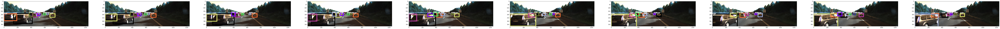

In [ ]:
visualize_images(yolo_images)

## 2) Hungarian Algorithm
— Copy and Paste the parts from the Hungarian Workshop

In [ ]:
def box_iou(box1, box2, w = 1280, h=360):
    xA = max(box1[0], box2[0])
    yA = max(box1[1], box2[1])
    xB = min(box1[2], box2[2])
    yB = min(box1[3], box2[3])

    inter_area = max(0, xB - xA + 1) * max(0, yB - yA + 1) #abs((xi2 - xi1)*(yi2 - yi1))
    # Calculate the Union area by using Formula: Union(A,B) = A + B - Inter(A,B)
    box1_area = (box1[2] - box1[0] + 1) * (box1[3] - box1[1] + 1) #abs((box1[3] - box1[1])*(box1[2]- box1[0]))
    box2_area = (box2[2] - box2[0] + 1) * (box2[3] - box2[1] + 1) #abs((box2[3] - box2[1])*(box2[2]- box2[0]))
    union_area = (box1_area + box2_area) - inter_area
    # compute the IoU
    iou = inter_area/float(union_area)
    return iou

In [ ]:
def check_division_by_0(value, epsilon=0.01):
    if value < epsilon:
        value = epsilon
    return value

In [ ]:
def sanchez_matilla(box1, box2, w = 1280, h=360):
    Q_dist = sqrt(pow(w,2)+pow(h,2)) # First real-life Pythagore use in your life
    Q_shape = w*h
    distance_term = Q_dist/check_division_by_0(sqrt(pow(box1[0] - box2[0], 2)+pow(box1[1] -box2[1],2)))
    shape_term = Q_shape/check_division_by_0(sqrt(pow(box1[2] - box2[2], 2)+pow(box1[3] - box2[3],2)))
    linear_cost = distance_term*shape_term
    return linear_cost

In [ ]:
from math import sqrt, exp

def yut(box1, box2):
    w1 = 0.5
    w2 = 1.5
    a= (box1[0] - box2[0])/check_division_by_0(box1[2])
    a_2 = pow(a,2)
    b = (box1[1] - box2[1])/check_division_by_0(box1[3])
    b_2 = pow(b,2)
    ab = (a_2+b_2)*w1*(-1)
    c = abs(box1[3] - box2[3])/(box1[3]+box2[3])
    d = abs(box1[2]-box2[2])/(box1[2]+box2[2])
    cd = (c+d)*w2*(-1)
    exponential_cost = exp(ab)*exp(cd)
    return exponential_cost

In [ ]:
def hungarian_cost(old_box, new_box, iou_thresh = 0.3, linear_thresh = 10000, exp_thresh = 0.5):
    iou_cost = box_iou(old_box, new_box)
    linear_cost = sanchez_matilla(old_box, new_box)
    exponential_cost = yut(old_box, new_box)
    if (iou_cost >= iou_thresh and linear_cost>=linear_thresh and exponential_cost>=exp_thresh):
        return iou_cost
    else:
        return 0

### Association

In [ ]:
def convert_boxes(xywh_boxes, w, h):
    left = xywh_boxes[0]*w
    top = xywh_boxes[1]*h
    right = xywh_boxes[2]*w
    bottom = xywh_boxes[3]*h
    return left, top, right, bottom

In [ ]:
out_imgs = []
bboxes = []

idx = 0
img_1 = track_images[idx]
img_2 = track_images[idx+1]

_, boxes_1 = run_obstacle_detection(img_1)
_, boxes_2 = run_obstacle_detection(img_2)

boxes_1_converted = []
boxes_2_converted = []

h,w,_ = img_1.shape

for box in boxes_1:
    boxes_1_converted.append(xywh_to_ltrb(box[0]*w, box[1]*h, box[2]*w, box[3]*h))

for box in boxes_2:
    boxes_2_converted.append(xywh_to_ltrb(box[0]*w, box[1]*h, box[2]*w, box[3]*h))

print(boxes_1_converted)
print(boxes_2_converted)

[(141, 124, 416, 398), (1, 146, 189, 334), (675, 173, 751, 250), (420, 169, 497, 246), (626, 176, 655, 204), (488, 175, 530, 218), (371, 175, 426, 231), (579, 173, 614, 208)]
[(116, 115, 414, 413), (673, 174, 749, 249), (1, 156, 174, 329), (416, 169, 494, 246), (626, 176, 653, 203), (477, 170, 529, 223), (371, 172, 423, 225), (579, 173, 614, 209)]


In [ ]:
from scipy.optimize import linear_sum_assignment

def associate(old_boxes, new_boxes):
    """
    old_boxes will represent the former bounding boxes (at time 0)
    new_boxes will represent the new bounding boxes (at time 1)
    Function goal: Define a Hungarian Matrix with IOU as a metric and return, for each box, an id
    """
    # Define a new IOU Matrix nxm with old and new boxes
    iou_matrix = np.zeros((len(old_boxes),len(new_boxes)),dtype=np.float32)

    # Go through boxes and store the IOU value for each box 
    # You can also use the more challenging cost but still use IOU as a reference for convenience (use as a filter only)
    for i,old_box in enumerate(old_boxes):
        for j,new_box in enumerate(new_boxes):
            #iou_matrix[i][j] = box_iou(old_box, new_box)
            iou_matrix[i][j] = hungarian_cost(old_box, new_box)

    # Call for the Hungarian Algorithm
    hungarian_row, hungarian_col = linear_sum_assignment(-iou_matrix)
    hungarian_matrix = np.array(list(zip(hungarian_row, hungarian_col)))

    # Create new unmatched lists for old and new boxes
    matches, unmatched_detections, unmatched_trackers = [], [], []

    # Go through the Hungarian Matrix, if matched element has IOU < threshold (0.3), add it to the unmatched 
    # Else: add the match    
    for h in hungarian_matrix:
        if(iou_matrix[h[0],h[1]]<0.3):
            unmatched_trackers.append(old_boxes[h[0]])
            unmatched_detections.append(new_boxes[h[1]])
        else:
            matches.append(h.reshape(1,2))
    
    if(len(matches)==0):
        matches = np.empty((0,2),dtype=int)
    else:
        matches = np.concatenate(matches,axis=0)
    
    # Go through old boxes, if no matched detection, add it to the unmatched_old_boxes
    for t,trk in enumerate(old_boxes):
	    if(t not in hungarian_matrix[:,0]):
		    unmatched_trackers.append(trk)
    
    # Go through new boxes, if no matched tracking, add it to the unmatched_new_boxes
    for d, det in enumerate(new_boxes):
        if(d not in hungarian_matrix[:,1]):
                unmatched_detections.append(det)
    
    return matches, unmatched_detections,unmatched_trackers

In [ ]:
matches, unmatched_detections, unmatched_trackers = associate(boxes_1_converted, boxes_2_converted)

In [ ]:
print(matches)

[[0 0]
 [1 2]
 [2 1]
 [3 3]
 [4 4]
 [5 5]
 [6 6]
 [7 7]]


In [ ]:
print(unmatched_detections)

[]


In [ ]:
print(unmatched_trackers)

[]


## 3) Hungarian Tracking Loop

In [ ]:
class Obstacle():
    def __init__(self, idx, box):
        """
        Init function. The obstacle must have an id and a box.
        """
        self.idx = idx
        self.box = box

In [ ]:
def main(input_image):
    global stored_obstacles
    global idx

    # 1 — Run Obstacle Detection & Convert the Boxes
    image = copy.deepcopy(input_image)
    h, w, _ = image.shape
    _, out_boxes = run_obstacle_detection(image)
    converted_boxes = []
    for box in out_boxes:
        converted_boxes.append(xywh_to_ltrb(box[0]*w, box[1]*h, box[2]*w, box[3]*h))
    
    # 2 — On First Iteration, Define New Obstacle Objects
    if (idx == 0):
        stored_obstacles = []
        for i, box in enumerate(converted_boxes): # For all detected boxes
            obs = Obstacle(idx, box) # Create an obstacle
            left, top, right, bottom = box
            cv2.rectangle(image, (box[0], box[1]), (box[2], box[3]), id_to_color(obs.idx), thickness=7) # Draw the box on the image with ids
            image = cv2.putText(image, str(obs.idx),(left - 10,top -10),cv2.FONT_HERSHEY_SIMPLEX, 1,id_to_color(obs.idx),thickness=4)
            stored_obstacles.append(obs) # Put every created obstacle in the final list                
            idx +=1 # Increase the id for every box
        print(stored_obstacles)
        return image, stored_obstacles

    #3 — On Later Iterations, Associate
    elif (idx != 0): # In case we already have obstacles from previous frame, work on association
        ## Before calling associate, we must create a list of old obstacles
        old_obstacles = [obs.box for obs in stored_obstacles] # Simply get the boxes
        matches, unmatched_detections, unmatched_tracks = associate(old_obstacles, out_boxes) # Associate the obstacles
        new_obstacles = []

        # For every match, change the obstacle value. ID = Matched ID; Box = New Box
        for match in matches:
            obs = Obstacle(stored_obstacles[match[0]].idx, out_boxes[match[1]])
            new_obstacles.append(obs)
        
        # Loop through all unmatched detections and add these as obstacles
        for new_obs in unmatched_detections:
            idx+=1
            obs = Obstacle(idx, new_obs)
            new_obstacles.append(obs)
        # For every obstacle, draw on the image and return it
        for i, obs in enumerate(new_obstacles):
            left, top, right, bottom = obs.box
            cv2.rectangle(image, (left, top), (right, bottom), id_to_color(obs.idx), thickness=7)
            image = cv2.putText(image, str(obs.idx),(left - 10,top - 10),cv2.FONT_HERSHEY_SIMPLEX, 1,id_to_color(obs.idx),thickness=4)                
        stored_obstacles = copy.deepcopy(new_obstacles)
        return image, stored_obstacles

In [ ]:
def main(input_image):
    """
    Receives an images
    Outputs the result image, and a list of obstacle objects 
    """
    global stored_obstacles # Will be used to keep track of obstacles information
    global idx # Will be used to keep track of id information
    # Run obstacle detection
    image = copy.deepcopy(input_image)
    h, w, _ = image.shape
    _, out_boxes = run_obstacle_detection(image)
    converted_boxes = []
    for box in out_boxes:
        left, top, right, bottom = xywh_to_ltrb(box[0]*w, box[1]*h, box[2]*w, box[3]*h)
        converted_boxes.append([left, top, right, bottom])
    
    # First iteration: Simply create obstacles and draw them
    if (idx == 0):
        stored_obstacles = []
        for i, box in enumerate(converted_boxes): # For all detected boxes
            obs = Obstacle(idx, box) # Create an obstacle
            cv2.rectangle(image, (box[0], box[1]), (box[2], box[3]), id_to_color(obs.idx), thickness=7) # Draw the box on the image with ids
            image = cv2.putText(image, str(obs.idx),(box[0] - 10,box[1] -10),cv2.FONT_HERSHEY_SIMPLEX, 1,id_to_color(obs.idx),thickness=4)
            stored_obstacles.append(obs) # Put every created obstacle in the final list                
            idx +=1 # Increase the id for every box
        return image, stored_obstacles

    elif (idx != 0): # In case we already have obstacles from previous frame, work on association
        ## Before calling associate, we must create a list of old obstacles
        old_obstacles = [obs.box for obs in stored_obstacles] # Simply get the boxes
        matches, unmatched_detections, unmatched_tracks = associate(old_obstacles, converted_boxes) # Associate the obstacles
        new_obstacles = []

        # For every match, change the obstacle value. ID = Matched ID; Box = New Box
        for match in matches:
            obs = Obstacle(stored_obstacles[match[0]].idx, converted_boxes[match[1]])
            new_obstacles.append(obs)
        
        # Loop through all unmatched detections and add these as obstacles
        for new_obs in unmatched_detections:
            idx+=1
            obs = Obstacle(idx, new_obs)
            new_obstacles.append(obs)
        
        # For every obstacle, draw on the image and return it
        for i, obs in enumerate(new_obstacles):
            cv2.rectangle(image, (obs.box[0], obs.box[1]), (obs.box[2], obs.box[3]), id_to_color(obs.idx), thickness=7)
            image = cv2.putText(image, str(obs.idx),(obs.box[0] - 10,obs.box[1] - 10),cv2.FONT_HERSHEY_SIMPLEX, 1,id_to_color(obs.idx),thickness=4)                
        stored_obstacles = copy.deepcopy(new_obstacles)
        return image, stored_obstacles

In [ ]:
### Call the main loop

idx = 0
fig=plt.figure(figsize=(100,100))
result_images_3 = copy.deepcopy(track_images)
out_imgs = []

for i in range(len(result_images_3)):
    out_img, stored_obstacles = main(result_images_3[i])
    out_imgs.append(out_img)
    fig.add_subplot(1, len(result_images_3), i+1)
    plt.imshow(out_imgs[i])

plt.show()

## Extra — Solving the Ghost & Missed Detection Issues

We now have a pretty good tracker! <p>
One thing that is not very good is that it relies solely on the detector.
If we miss the detection, we miss everything. <p>

In this part, we'll treat two issues:
* **False Positives** — ghosts, unwanted detections, ...
* **False Negatives** — missed detections.

> We'll solve the False Positive problem by introducing a **MIN_HIT_STREAK** variable. If the detector detects something once, it is not displayed. If it **detects it twice in a row**, or 3 times in a row (thanks to matching), it is displayed.

> We'll solve the False Negative Problem by introducing a **MAX_AGE** variable. If an obstacle is suddently unmatched, we **keep displaying** it. If it is unmatched again, or more times, we remove it.

In [ ]:
MIN_HIT_STREAK = 1
MAX_UNMATCHED_AGE = 2

**Obstacle Class** <p>
Let's redefine the Obstacle class to include these values
Every obstacle should have:
* an id
* a box
* an age (number of times matched)
* an unmatched frame number (number of times unmatched)

In [ ]:
class Obstacle():
    def __init__(self, idx, box, age=1, unmatched_age=0):
        self.idx = idx
        self.box = box
        self.age = age
        self.unmatched_age = unmatched_age

**Main Loop** <p>
We'll now change the main loop to consider these issues:

In [ ]:
def main(input_image):
    """
    Receives an images
    Outputs the result image, and a list of obstacle objects 
    """
    global stored_obstacles # Will be used to keep track of obstacles information
    global idx # Will be used to keep track of id information
    # Run obstacle detection
    image = copy.deepcopy(input_image)
    h, w, _ = image.shape
    _, out_boxes = run_obstacle_detection(image)
    converted_boxes = []
    for box in out_boxes:
        left, top, right, bottom = xywh_to_ltrb(box[0]*w, box[1]*h, box[2]*w, box[3]*h)
        converted_boxes.append([left, top, right, bottom])
    
    # What we will do will be very similar but we have a second list of obstacles that answer to the conditions
    # On first iteration, we only create obstacles with age=1
    if (idx == 0):
        stored_obstacles = []
        for i, box in enumerate(converted_boxes): # For all detected boxes
            obs = Obstacle(idx, box, age =1, unmatched_age =0) # Create an obstacle
            cv2.rectangle(image, (box[0], box[1]), (box[2], box[3]), id_to_color(obs.idx), thickness=7) # Draw the box on the image with ids
            image = cv2.putText(image, str(obs.idx),(box[0] - 10,box[1] -10),cv2.FONT_HERSHEY_SIMPLEX, 1,id_to_color(obs.idx),thickness=4)
            stored_obstacles.append(obs) # Put every created obstacle in the final list                
            idx +=1 # Increase the id for every box
        return image, stored_obstacles
    
    # On this case, if the obstacle has already been matched, we display it depending on the MIN_HIT_STREAK variable
    elif (idx != 0): # In case we already have obstacles from previous frame, work on association
        ## Before calling associate, we must create a list of old obstacles
        old_obstacles = [obs.box for obs in stored_obstacles] # Simply get the boxes
        matches, unmatched_detections, unmatched_tracks = associate(old_obstacles, converted_boxes) # Associate the obstacles        
        new_obstacles = []

        # Loop through all matches and add these as obstacles
        for match in matches:
            obs = Obstacle(stored_obstacles[match[0]].idx, converted_boxes[match[1]], stored_obstacles[match[0]].age +1) # Increase the age by 1
            if obs.age >= MIN_HIT_STREAK:
                new_obstacles.append(obs)
        
        # Loop through all unmatched detections and add these as obstacles
        for new_obs in unmatched_detections:
            idx +=1
            obs = Obstacle(idx, new_obs)
            if obs.age >= MIN_HIT_STREAK:
                new_obstacles.append(obs)

        for i, old_obs in enumerate(unmatched_tracks):
            if stored_obstacles[i].box == old_obs:
                obs = stored_obstacles[i] 
                obs.unmatched_age +=1
                if obs.unmatched_age <= MAX_UNMATCHED_AGE:
                    new_obstacles.append(obs)

        # Draw on selected obstacles only
        for i, obs in enumerate(new_obstacles):
            cv2.rectangle(image, (obs.box[0], obs.box[1]), (obs.box[2], obs.box[3]), id_to_color(obs.idx), thickness=10)
            image = cv2.putText(image, str(obs.idx),(left,top),cv2.FONT_HERSHEY_SIMPLEX, 1,id_to_color(obs.idx),thickness=4)                

        stored_obstacles = copy.deepcopy(new_obstacles)
        return image, stored_obstacles

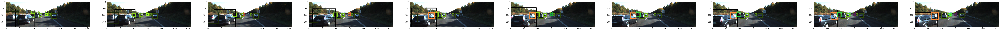

In [ ]:
### Call the main loop

idx = 0
fig=plt.figure(figsize=(100,100))
result_images_3 = copy.deepcopy(track_images)
out_imgs = []

for i in range(len(result_images_3)):
    out_img, stored_obstacles = main(result_images_3[i])
    out_imgs.append(out_img)
    fig.add_subplot(1, len(result_images_3), i+1)
    plt.imshow(out_imgs[i])

plt.show()

# Video


Now is the time to run on a video. 

In [ ]:
import glob 
from tqdm import tqdm

video_images = sorted(glob.glob("data/*.png"))
result_video = []

for img in tqdm(video_images):
    out_img, stored_obstacles = main(cv2.cvtColor(cv2.imread(img), cv2.COLOR_BGR2RGB))
    result_video.append(out_img)

 53%|█████▎    | 445/837 [01:04<00:56,  6.91it/s]


KeyboardInterrupt: ignored

In [ ]:
out = cv2.VideoWriter('out_hungarian.mp4',cv2.VideoWriter_fourcc(*'MP4V'), 15, (out_img.shape[1],out_img.shape[0]))

for img in result_video:
  out.write(img)
out.release()

In [ ]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('out_hungarian.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=800 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)